## folium 개요

folium은 `leaflet.js` 기반으로 만들어진 Python 지도 시각화 라이브러리 입니다.

[도큐먼트](https://python-visualization.github.io/folium/)

folium을 사용하여 인터랙티브한 지도를 생성하고 **마커를 추가**하여 시각화하거나<br>**원으로 범위를 표기**하고 `html` 파일로 내보내기 등을 수행할 수 있습니다.

## folium 설치

`pip install folium`으로 라이브러리를 설치할 수 있습니다.

In [6]:
# !pip install folium

모듈 import 

In [1]:
import folium

import matplotlib.pyplot as plt
import seaborn as sns

plt.rc("font", family="Malgun Gothic")
sns.set_theme(font="Malgun Gothic", 
              rc={"axes.unicode_minus":False}, style='darkgrid')

## 기본 좌표 설정

`location`에 위도, 경도 정보를 입력하여 입력한 **위,경도 좌표**를 기준으로 지도를 그릴 수 있습니다.

이때 `zoom_start` 정보를 지정하여 **확대**의 정도를 지정할 수 있습니다.

- 참고: `zoom_start`의 범위는 **최대 18** 입니다.

In [6]:
# 위도
latitude = 37.473514

# 경도
longitude = 127.141987

In [12]:
# 코드입력
fm = folium.Map(location=[latitude, longitude],
                zoom_start=17,
                width=720, height=405)
fm

## 마커 추가

- `location`: 마커를 추가할 **위도/경도 좌표**를 입력 후 
- `popup`: 표기할 팝업 문구 지정 (마우스 클릭시 표기되는 문구)
- `tooltip`: 표기할 툴팁 지정 (마우스 오버시 표기되는 문구)

마커를 생성 후 기존에 생성된 지도 `m`에 추가합니다.

In [8]:
folium.Marker([latitude, longitude],
              popup='홈',
              tooltip='집 근처'
              ).add_to(fm)
fm

마커에 대한 스타일 변경도 가능합니다. 스타일 변경시 `icon` 파라미터에 `folium.Icon(color=?, icon=?)`을 지정합니다.

In [9]:
folium.Marker([latitude, longitude],
              popup='홈',
              tooltip='집 근처',
              icon=folium.Icon('red', icon='star')
              ).add_to(fm)
fm

`popup`이나 `tooltip`에 다음과 같이 `html 코드`를 삽입하여 이미지를 표기하거나 심지어 YouTube 영상도 삽입할 수 있습니다.

In [16]:
youtube_share = '''<iframe width="560" height="315"
 src="https://www.youtube.com/embed/5cGlgz59pdI?si=9Oq-jempGnHnJtKt"
   title="YouTube video player"
     frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture; web-share"
       referrerpolicy="strict-origin-when-cross-origin" allowfullscreen></iframe>'''

In [17]:
folium.Marker([latitude, longitude],
              popup=folium.Popup(html=youtube_share),
              tooltip="집 근처"
              ).add_to(fm)
fm

In [18]:
folium.CircleMarker([latitude, longitude],
                    color='tomato',
                    radius = 50, 
                    tooltip='집 근처'
                    ).add_to(fm)
fm

## 실습에 필요한 데이터셋

[소상공인 시장 진흥공단 상권정보](https://www.data.go.kr/data/15083033/fileData.do#layer_data_infomation)

In [ ]:
# !pip install teddynote -q

In [20]:
# from teddynote import dataset

# dataset.download('소상공인상권정보')

In [2]:
import pandas as pd

df = pd.read_csv('data/상권정보_경기.csv', dtype={'지점명':'str'}, encoding='utf-8')
df.head(2)

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0071854,희야,NaN,I2,음식,I203,일식,I20301,일식 회/초밥,I56122,...,4122010100108160002005525,NaN,경기도 평택시 특구로23번길 19,459813.0,17774,NaN,1,NaN,127.062091,37.067553
1,MA0101202210A0076234,비에이치씨충호회관점,NaN,I2,음식,I210,기타 간이,I21006,치킨,I56193,...,4136025024203190001025405,NaN,경기도 남양주시 와부읍 석실로260번길 74-17,472905.0,12203,NaN,1,NaN,127.225686,37.602928


컬럼 정보를 출력 합니다.

In [25]:
pd.Series(df.columns)

0        상가업소번호
1           상호명
2           지점명
3     상권업종대분류코드
4      상권업종대분류명
5     상권업종중분류코드
6      상권업종중분류명
7     상권업종소분류코드
8      상권업종소분류명
9      표준산업분류코드
10      표준산업분류명
11         시도코드
12          시도명
13        시군구코드
14         시군구명
15        행정동코드
16         행정동명
17        법정동코드
18         법정동명
19         지번코드
20       대지구분코드
21        대지구분명
22        지번본번지
23        지번부번지
24         지번주소
25        도로명코드
26          도로명
27        건물본번지
28        건물부번지
29       건물관리번호
30          건물명
31        도로명주소
32        구우편번호
33        신우편번호
34          동정보
35          층정보
36          호정보
37           경도
38           위도
dtype: object

행정동명이 `백현동`, `정자동`, `삼평동` 인 지역만 불러옵니다

In [5]:
sub_df = df.loc[df['행정동명'].isin(['백현동', '정자동', '삼평동'])]
sub_df.head(3)

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
368,MA010120220805447350,삼성공인중개사사무소,NaN,L1,부동산,L102,부동산 서비스,L10203,부동산 중개/대리업,L68221,...,4113510900101810001000002,봇들마을9단지금호어울림아파트,경기도 성남시 분당구 동판교로 156,463899.0,13526,NaN,1,NaN,127.119532,37.395075
445,MA010120220805449764,이가네양갈비,NaN,I2,음식,I201,한식,I20107,돼지고기 구이/찜,I56113,...,4113511000105300000000001,알파리움2단지,경기도 성남시 분당구 판교역로 145,463420.0,13530,NaN,1,NaN,127.108336,37.394396
530,MA010120220805442487,준오헤어,NaN,S2,수리·개인,S207,이용·미용,S20701,미용실,S96112,...,4113511000100000000000001,알파돔타워,경기도 성남시 분당구 판교역로 152,463420.0,13529,NaN,3,NaN,127.110292,37.394240


In [6]:
sub_df[['위도', '경도', '상호명']]

,위도,경도,상호명
368,37.395075,127.119532,삼성공인중개사사무소
445,37.394396,127.108336,이가네양갈비
530,37.394240,127.110292,준오헤어
545,37.400251,127.106878,종로계림닭도리탕원조
548,37.372010,127.112632,씨유분당정자
...,...,...,...
553967,37.387545,127.116266,메가엠지씨커피판교백현화랑초점
554152,37.368840,127.114080,신사부
554375,37.402098,127.110447,죽도령
554530,37.371937,127.112531,노바뮤직


## 클러스터 생성

In [7]:
latitude, longitude = 37.399482, 127.107934

In [8]:
from folium.plugins import MarkerCluster

fm2 = folium.Map(
    location=[latitude, longitude],
    zoom_start=15
)

coords = sub_df[['위도', '경도']]

In [9]:
marker_cluster = MarkerCluster().add_to(fm2)

for lat, lon in zip(coords['위도'], coords['경도']):
    folium.Marker([lat, lon],
                  icon=folium.Icon(color='green')
                  ).add_to(marker_cluster)

In [10]:
fm2

## 서울 지도에서 행정 구역별 표시

In [11]:
import requests
import json

# 서울 행정구역 json raw파일(githubcontent)
r = requests.get('https://raw.githubusercontent.com/southkorea/seoul-maps/master/kostat/2013/json/seoul_municipalities_geo_simple.json')
c = r.content
seoul_geo = json.loads(c)
seoul_geo

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'code': '11250',
    'name': '강동구',
    'name_eng': 'Gangdong-gu',
    'base_year': '2013'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[127.11519584981606, 37.557533180704915],
      [127.11879551821994, 37.557222485451305],
      [127.12146867175024, 37.55986003393365],
      [127.12435254630417, 37.56144246249796],
      [127.13593925898998, 37.56564793048277],
      [127.14930548011061, 37.56892250303897],
      [127.15511020940411, 37.57093642128295],
      [127.16683184366129, 37.57672487388627],
      [127.17038810813094, 37.576465605301046],
      [127.17607118428914, 37.57678573961056],
      [127.17905504160184, 37.57791388161732],
      [127.17747787800164, 37.57448983055031],
      [127.1781775408844, 37.571481967974336],
      [127.17995281860672, 37.569309661290504],
      [127.18122821955262, 37.56636089217979],
      [127.18169407550688, 37.56286338914073],
      [127.18408792

서울 지역의 구별 boundary 시각화

In [12]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
)

folium.GeoJson(seoul_geo,
               name='지역구'
               ).add_to(m)
m

## tiles 옵션 변경을 통해 지도의 테마 변경

지도의 기본 테마(tiles)는 `OpenStreetMap`으로 설정되어 있는데, 이를 변경하여 다른 지도 테마를 적용할 수 있다.

### `Stamen Toner` 적용시

In [13]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    # 타일변경
    tiles='Stamen Toner'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

### `cartodbpositron` 적용시

In [18]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    # 타일변경
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

## 서울시 자치구별 상권정보 시각화

- [소상공인시장진흥공단 상권 정보 데이터셋 다운로드](https://www.data.go.kr/data/15083033/fileData.do)

`seoul` 데이터프레임에 소상공인시장진흥공단에서 제공하는 **서울시 상권정보 csv 파일**을 로드합니다. 

In [22]:
import pandas as pd

seoul = pd.read_csv('data/상권정보_서울.csv', dtype={'지점명':'str'}, encoding='utf-8')

seoul = seoul[['시군구명', '상권업종대분류명', '상권업종중분류명', '위도', '경도']]
seoul.head(2)

,시군구명,상권업종대분류명,상권업종중분류명,위도,경도
0,양천구,과학·기술,사진 촬영,37.542117,126.828832
1,강서구,음식,한식,37.560053,126.833022


시각화 모듈을 import 하고 **서울시의 업종별 개수**를 시각화합니다.

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

서울시의 `상권업종중분류명`에 따른 데이터 개수를 시각화 합니다.

In [27]:
seoul['상권업종중분류명'].value_counts()

한식             45482
이용·미용          27963
기타 간이          26134
섬유·의복·신발 소매    25506
부동산 서비스        23537
               ...  
병원               369
장례식장             331
통신장비 수리          296
조경·유지            104
기타 외국             42
Name: 상권업종중분류명, Length: 75, dtype: int64

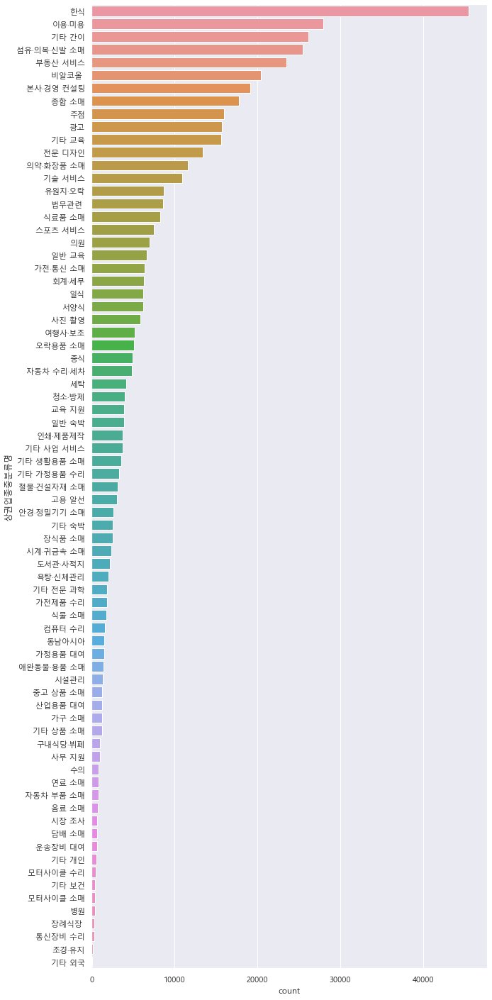

In [28]:
plt.figure(figsize=(10, 25))
sns.countplot(data=seoul, y='상권업종중분류명', order=seoul['상권업종중분류명'].value_counts().index)
plt.show()

* 24년 9월 기준으로 서울에는 카페(비알코올)가 가장 많을 것으로 예상했으나 **한식 업종이 가장 많다.**

그럼 **카페(비알코올)** 업종은 자치구별로 **어느 곳에 가장 많이 분포**해 있는가?

In [30]:
seoul['상권업종중분류명'].unique()

array(['사진 촬영', '한식', '기타 간이', '의약·화장품 소매', '광고', '운송장비 대여', '비알코올 ',
       '기타 교육', '일반 숙박', '섬유·의복·신발 소매', '부동산 서비스', '법무관련 ', '욕탕·신체관리',
       '자동차 수리·세차', '시계·귀금속 소매', '본사·경영 컨설팅', '전문 디자인', '주점', '회계·세무',
       '스포츠 서비스', '중고 상품 소매', '종합 소매', '기술 서비스', '세탁', '이용·미용', '의원',
       '동남아시아', '기타 가정용품 수리', '애완동물·용품 소매', '기타 전문 과학', '유원지·오락', '교육 지원',
       '청소·방제', '기타 사업 서비스', '가정용품 대여', '중식', '고용 알선', '장식품 소매', '여행사·보조',
       '기타 개인', '음료 소매', '가전·통신 소매', '일반 교육', '구내식당·뷔페', '식료품 소매',
       '기타 상품 소매', '기타 생활용품 소매', '서양식', '식물 소매', '일식', '기타 숙박', '오락용품 소매',
       '컴퓨터 수리', '인쇄·제품제작', '도서관·사적지', '병원', '모터사이클 소매', '담배 소매', '시설관리',
       '가구 소매', '시장 조사', '수의', '가전제품 수리', '기타 보건', '모터사이클 수리',
       '자동차 부품 소매', '안경·정밀기기 소매', '철물·건설자재 소매', '산업용품 대여', '사무 지원',
       '통신장비 수리', '연료 소매', '조경·유지', '장례식장 ', '기타 외국'], dtype=object)

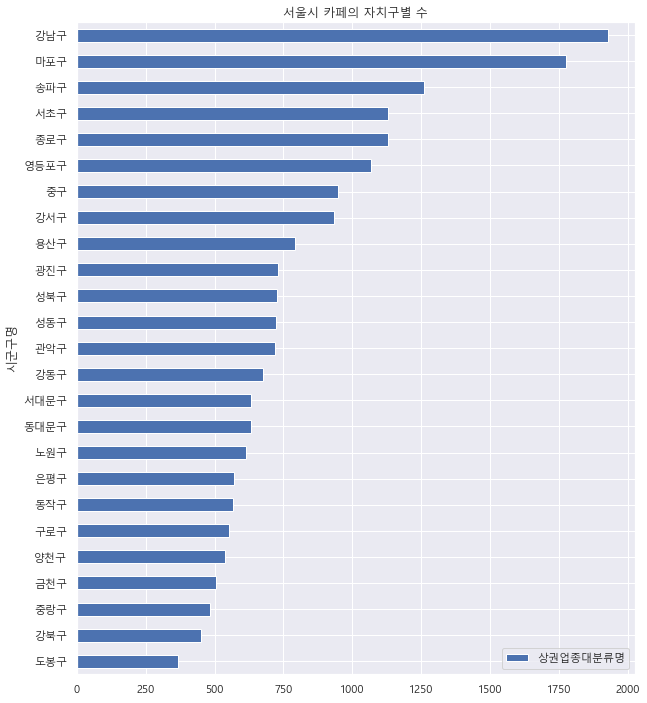

In [45]:
# 자치구별 카페업종의 분포 수
seoul_nonalc = seoul.loc[seoul['상권업종중분류명'] == '비알코올 '].groupby('시군구명')['상권업종대분류명'].count().to_frame().sort_values(by='상권업종대분류명')
seoul_nonalc.plot(kind='barh', figsize=(10, 12))
plt.title('서울시 카페의 자치구별 수')
plt.show()

* 카페는 강남구가 가장 많은 수를 차지하고 도봉구는 가장 적은 수를 차지

folium 위에 시각화

In [47]:
seoul_coffee = seoul.loc[seoul['상권업종중분류명'] == '비알코올 ']

In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=12, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

클러스터를 추가하여 지도위에 시각화 합니다.

In [50]:
marker_cluster = MarkerCluster().add_to(m)

for lat, lon in zip(seoul_coffee['위도'], seoul_coffee['경도']):
    folium.Marker([lat, lon],
                  icon=folium.Icon(color='green')
                  ).add_to(marker_cluster)
    
m

In [51]:
seoul_coffee_gu = seoul.loc[seoul['상권업종중분류명'] == '비알코올 '].groupby('시군구명')['상권업종중분류명'].count()
seoul_coffee_gu

시군구명
강남구     1928
강동구      677
강북구      452
강서구      932
관악구      721
광진구      731
구로구      553
금천구      507
노원구      614
도봉구      366
동대문구     632
동작구      567
마포구     1775
서대문구     632
서초구     1131
성동구      723
성북구      727
송파구     1259
양천구      539
영등포구    1068
용산구      791
은평구      570
종로구     1128
중구       947
중랑구      484
Name: 상권업종중분류명, dtype: int64

`choropleth` 를 사용하여 시각화를 하면 업종 별 개수에 따른 색상의 차이를 두어 시각화를 해줍니다.

In [52]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

In [55]:
seoul_geo

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'code': '11250',
    'name': '강동구',
    'name_eng': 'Gangdong-gu',
    'base_year': '2013'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[127.11519584981606, 37.557533180704915],
      [127.11879551821994, 37.557222485451305],
      [127.12146867175024, 37.55986003393365],
      [127.12435254630417, 37.56144246249796],
      [127.13593925898998, 37.56564793048277],
      [127.14930548011061, 37.56892250303897],
      [127.15511020940411, 37.57093642128295],
      [127.16683184366129, 37.57672487388627],
      [127.17038810813094, 37.576465605301046],
      [127.17607118428914, 37.57678573961056],
      [127.17905504160184, 37.57791388161732],
      [127.17747787800164, 37.57448983055031],
      [127.1781775408844, 37.571481967974336],
      [127.17995281860672, 37.569309661290504],
      [127.18122821955262, 37.56636089217979],
      [127.18169407550688, 37.56286338914073],
      [127.18408792

In [57]:
m.choropleth(geo_data=seoul_geo,
             data=seoul_coffee_gu,
             fill_color='YlOrRd',
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name', # seoul_geo의 구와 seoul_coffe_gu의 구를 JOIN
             legend_name='지역구별 커피 업종 수'
             )
m

c:\Users\gabri\.conda\envs\spatial\lib\site-packages\folium\folium.py:409: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


`bins`를 만들어 **1/4, 2/4, 3/4분위수별**로 구간을 나누어 시각화할 수 있습니다.

In [59]:
list(seoul_coffee_gu.quantile([0, 0.25, 0.5, 0.75, 1]))

[366.0, 567.0, 721.0, 947.0, 1928.0]

In [60]:
# 코드입력
bins = list(seoul_coffee_gu.quantile([0, 0.25, 0.5, 0.75, 1]))

m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m.choropleth(geo_data=seoul_geo,
             data=seoul_coffee_gu, 
             fill_color='YlOrRd', # 색상 변경도 가능하다
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name',
             legend_name="지역구별 커피 업종 수", 
             bins=bins
            )
m

c:\Users\gabri\.conda\envs\spatial\lib\site-packages\folium\folium.py:409: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


## Html 파일로 저장

저장은 `save()` 함수로 쉽게 html 파일로 저장할 수 있습니다.

In [61]:
m.save('map.html')

## 참고 (References)

- [Folium 0.12.1 documentation](https://python-visualization.github.io/folium/)
- [folium을 이용하여 서울시 동별 인구 수 시각화하기](https://d-hyeon.tistory.com/2)
- [지도 핸들링_folium](https://m.blog.naver.com/PostView.naver?isHttpsRedirect=true&blogId=jymoon1115&logNo=221392797679)